## Setup

In [3]:
# Import statements

import rioxarray  # noqa: F401
import xarray as xr
import matplotlib.pyplot as plt
from typing import List
import cartopy.crs as ccrs
import numpy as np
import cartopy.feature as cfeature
from scipy.ndimage import sobel, label
from skimage.filters import scharr
from metpy.calc import (
    laplacian,
    smooth_gaussian,
    gradient,
    potential_temperature,
    equivalent_potential_temperature,
    frontogenesis
)
from metpy.units import units
from skimage import transform
import pint
import matplotlib.lines as mlines

# Set default style to dark background because I like it better
plt.style.use("dark_background")
plt.rcParams["hatch.linewidth"] = 0.3


In [14]:
# Define useful functions
def get_wofs_all(init: int) -> xr.Dataset:
    """Read in WoFS output based on initialization time."""
    file_pattern = f"/mnt/drive2/new-wofs/{init:02d}Z/wofs_ALL*.nc"
    loaded = xr.open_mfdataset(
        file_pattern, combine="nested", concat_dim="time", chunks="auto"
    )

    if init < 6:
        start_time = f"2021-09-02 {init:02d}:00:00"
        end_time = f"2021-09-02 {init + 6:02d}:00:00"
    elif init == 17:
        start_time = f"2021-09-01 {init:02d}:00:00"
        end_time = f"2021-09-01 {init + 6:02d}:00:00"
    else:
        start_time = f"2021-09-01 {init:02d}:00:00"
        end_time = f"2021-09-02 {init - 24 + 6:02d}:00:00"

    loaded["time"] = xr.cftime_range(start_time, end_time, freq="5min")
    return loaded


def get_field(
    wofs_list: List[xr.Dataset],
    varname: str,
    start_time: str,
    end_time: str,
    init_dim: xr.DataArray,
) -> xr.DataArray:
    """
    Return a field (varname) for a given time slice across multiple datasets.

    Parameters:
    wofs_list (List[xr.Dataset]): List of xarray datasets.
    varname (str): Name of the variable from the Dataset to get.
    start_time (str): Start time for the time slice (format: 'YYYY-MM-DD HH:MM:SS').
    end_time (str): End time for the time slice (format: 'YYYY-MM-DD HH:MM:SS').
    init_dim (str): Name of the dimension to concatenate along.

    Returns:
    xr.DataArray: Summed-up variable concatenated along the specified dimension.
    """
    return xr.concat(
        [w[varname].sel(time=slice(start_time, end_time)) for w in wofs_list],
        dim=init_dim,
    ).chunk({"init": -1})

def get_total_field(
    wofs_list: List[xr.Dataset],
    varname: str,
    start_time: str,
    end_time: str,
    init_dim: xr.DataArray,
) -> xr.DataArray:
    """
    Calculate the sum of a field (varname) for a given time slice across multiple datasets.

    Parameters:
    wofs_list (List[xr.Dataset]): List of xarray datasets.
    varname (str): Name of the variable from the Dataset to get.
    start_time (str): Start time for the time slice (format: 'YYYY-MM-DD HH:MM:SS').
    end_time (str): End time for the time slice (format: 'YYYY-MM-DD HH:MM:SS').
    init_dim (str): Name of the dimension to concatenate along.

    Returns:
    xr.DataArray: Summed-up variable concatenated along the specified dimension.
    """
    return xr.concat(
        [
            w[varname].sel(time=slice(start_time, end_time)).sum(dim="time")
            for w in wofs_list
        ],
        dim=init_dim,
    ).chunk({"init": -1})

def get_biggest_blob(array_in: pint.Quantity) -> pint.Quantity:
    "Label all blobs and only return the biggest one"
    # Identify blobs
    labeled_array, num_features = label(np.isfinite(array_in))  # type: ignore

    # Find largest blob
    largest_blob_size, largest_blob_label = 0, None
    for l_idx in range(1, num_features + 1):
        blob_size = np.sum(labeled_array == l_idx)
        if blob_size > largest_blob_size:
            largest_blob_size, largest_blob_label = blob_size, l_idx

    return np.where(labeled_array == largest_blob_label, array_in, np.nan)  # type: ignore



In [5]:
# Read in 20-23Z initializations
wofs_all = [get_wofs_all(n) for n in range(20,24,1)]

# Define variables and parameters
lat = wofs_all[0].xlat.isel(time=0).squeeze().drop_vars("time")
lon = wofs_all[0].xlon.isel(time=0).squeeze().drop_vars("time")

# Set up Cartopy projection
proj = ccrs.LambertConformal(
    central_longitude=wofs_all[0].attrs["CEN_LON"],
    central_latitude=wofs_all[0].attrs["CEN_LAT"],
    standard_parallels=(30, 60),
)  # WoFS projection

# Create a DataArray for the initialization dimension
init = xr.DataArray(data=["20Z", "21Z", "22Z", "23Z"], dims="init").assign_coords(
    {"init": ["20Z", "21Z", "22Z", "23Z"]}
)


In [6]:
# Get the 01 to 02 UTC rainfall
rain12 = get_total_field(
    wofs_all, "rain", "2021-09-02 01:05:00", "2021-09-02 02:00:00", init_dim=init
)
# rain01 = get_total_field(wofs_all, "rain", "2021-09-02 00:05:00", "2021-09-02 01:00:00", init_dim=init)

# Calculate standard deviation of rainfall
std = rain12.std(dim=("init", "ne"))

# Lastly, make our area of interest where sd > 65% of max sd
aoi = std > (std.max() * 0.65)

rain12_aoi = rain12.where(aoi).mean(dim=("lat", "lon"), skipna=True)

# Grab the 5 wettest and driest ensemble members
ranking = [r.ne.sortby(r).load() for r in rain12_aoi]
driest, wettest = [r[:5] for r in ranking], [r[-5:] for r in ranking]

# Get the indices of the wettest and driest ensemble members
ne_wet = [
    r.ne.where(r > r.quantile(0.75, dim="ne")).dropna(dim="ne").drop_vars("quantile")
    for r in rain12_aoi
]
ne_dry = [
    r.ne.where(r < r.quantile(0.25, dim="ne")).dropna(dim="ne").drop_vars("quantile")
    for r in rain12_aoi
]

# Select wet and dry members
wofs_wet = [wofs_all[i].sel(ne=ne_wet[i].astype(int)) for i in range(len(wofs_all))]
wofs_dry = [wofs_all[i].sel(ne=ne_dry[i].astype(int)) for i in range(len(wofs_all))]


## Wettest and Driest Members

The wettest member: Index 10 @ 23Z
The driest member: Index 16 @ 20Z

In [7]:
thetae = get_field(
    wofs_all, "theta_e", "2021-09-02 01:00:00", "2021-09-02 01:00:00", init
).squeeze()


In [8]:
thetae_wet = thetae.sel(init="23Z").isel(ne=10) * units.degree_Kelvin
thetae_dry = thetae.sel(init="20Z").isel(ne=16) * units.degree_Kelvin

dx = 3 * 1000 * units.meter
dy = 3 * 1000  * units.meter

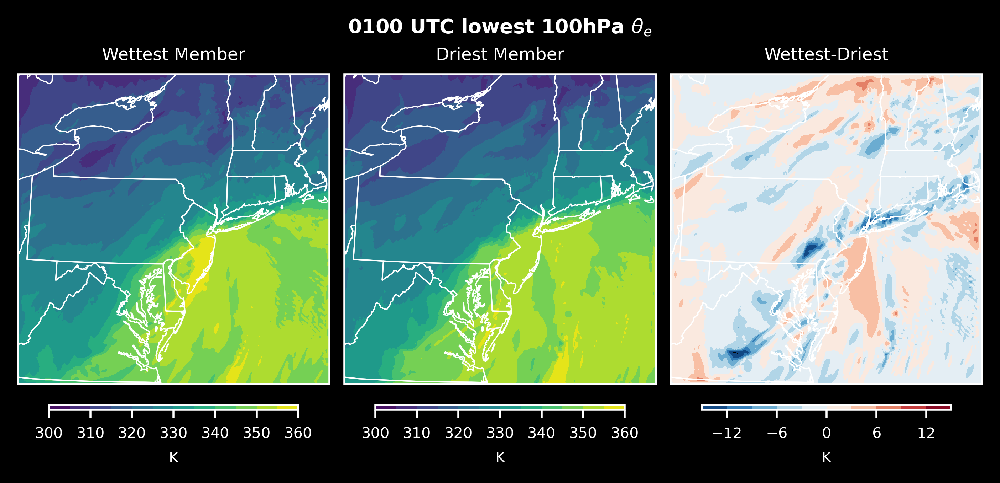

In [9]:
data = [thetae_wet, thetae_dry, thetae_wet - thetae_dry]
titles = ["Wettest Member","Driest Member", "Wettest-Driest"]

# Increase the figure height to make more room vertically
fig, axes = plt.subplots(
    1,
    3,
    figsize=(5.5, 2.5),  # Increased height from 3 to 4
    dpi=500,
    layout="constrained",
    subplot_kw=dict(projection=proj),
)

# Adjust the suptitle position to be higher up
fig.suptitle(
    r"0100 UTC lowest 100hPa $\theta_e$",
    fontsize=8,
    y=1.02,
    fontweight="bold"
)

for i, ax in enumerate(axes.flat):
    if i < 2:
        cf = ax.contourf(
            lon, lat, data[i], transform=ccrs.PlateCarree(), levels=range(300, 361, 5)
        )
    else:
        cf = ax.contourf(
            lon,
            lat,
            data[i],
            transform=ccrs.PlateCarree(),
            levels=range(-15, 16, 3),
            cmap="RdBu_r",
        )
    ax.set_extent(
        [
            -449900.09156094893,
            449900.51654555957,
            -447909.5438942791,
            448284.39736015256,
        ],
        crs=proj,
    )

    # Add state borders for each subplot
    ax.add_feature(cfeature.STATES, linewidth=0.5, edgecolor="white")

    cb = fig.colorbar(
        cf, ax=ax, orientation="horizontal", shrink=0.8, aspect=50, extend="both"
    )
    cb.ax.tick_params(labelsize=6)
    cb.set_label("K", fontsize=6)

    ax.set_title(titles[i],fontsize=7)

plt.show()

## Theta-e

### Gradient

In [28]:
# set smoothing sigma
sigma = 30

# calculate gradient
grad_thetae_wet = gradient(smooth_gaussian(thetae_wet,n=sigma),deltas=(dy,dx))
grad_thetae_dry = gradient(smooth_gaussian(thetae_dry,n=sigma),deltas=(dy,dx))

# magnitude of gradient
mag_grad_wet = np.sqrt(grad_thetae_wet[0]**2 + grad_thetae_wet[1]**2)
mag_grad_dry = np.sqrt(grad_thetae_dry[0]**2 + grad_thetae_dry[1]**2)

print(((mag_grad_wet).to("K/km")*100).max())


46.140594274674804 kelvin / kilometer


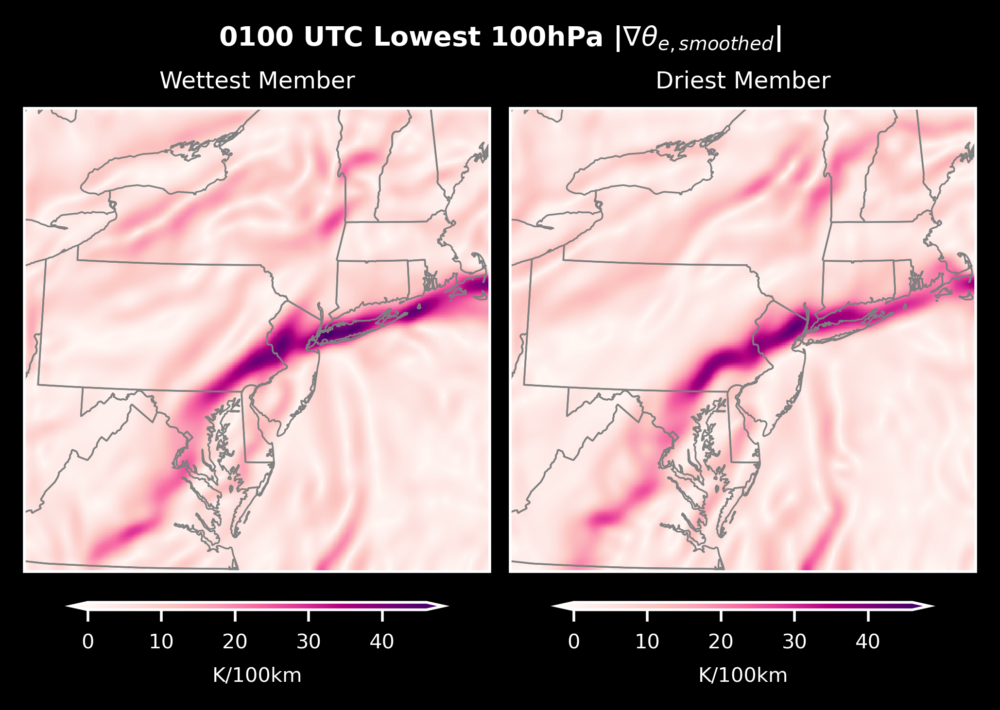

In [31]:
data = [mag_grad_wet, mag_grad_dry]
titles = ["Wettest Member", "Driest Member"]

# Increase the figure height to make more room vertically
fig, axes = plt.subplots(
    1,
    2,
    figsize=(4, 2.7),
    dpi=500,
    layout="constrained",
    subplot_kw=dict(projection=proj),
)

# Adjust the suptitle position to be higher up
fig.suptitle(
    r"0100 UTC Lowest 100hPa |$\nabla \theta_{e,smoothed}$|", fontsize=8, y=1.02, fontweight="bold"
)

for i, ax in enumerate(axes.flat):
    if i < 2:
        cf = ax.pcolormesh(
            lon,
            lat,
            np.array(data[i].to("K/km") * 100),
            transform=ccrs.PlateCarree(),
            vmin=0,
            vmax=46,
            cmap = "RdPu"
        )
    ax.set_extent(
        [
            -449900.09156094893,
            449900.51654555957,
            -447909.5438942791,
            448284.39736015256,
        ],
        crs=proj,
    )

    # Add state borders for each subplot
    ax.add_feature(cfeature.STATES, linewidth=0.5, edgecolor="gray")

    cb = fig.colorbar(
        cf, ax=ax, orientation="horizontal", shrink=0.8, aspect=50, extend="both"
    )
    cb.ax.tick_params(labelsize=6)
    cb.set_label(r"K/100km", fontsize=6)

    ax.set_title(titles[i], fontsize=7)

plt.show()


### Laplacian

In [9]:
thetae_wet_lap = laplacian(smooth_gaussian(thetae_wet * units.kelvin,n=10),deltas=(dy,dx))
thetae_dry_lap = laplacian(smooth_gaussian(thetae_dry * units.kelvin,n=10),deltas=(dy,dx))

print(abs(thetae_wet_lap.max()))
print(abs((thetae_wet_lap - thetae_dry_lap).max()))

1.6101792622254588e-07 kelvin ** 2 / meter ** 2
1.7772766910750744e-07 kelvin ** 2 / meter ** 2


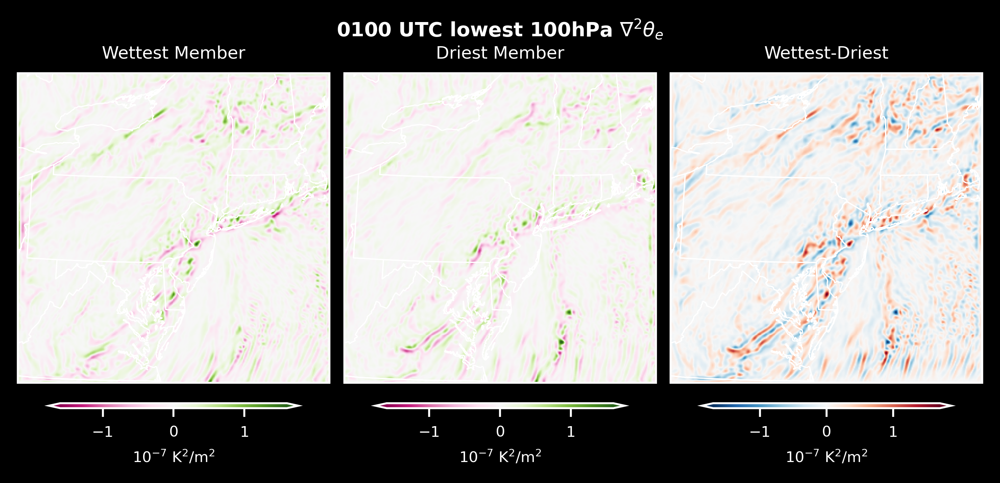

In [13]:
data = [thetae_wet_lap, thetae_dry_lap, thetae_wet_lap - thetae_dry_lap]
titles = ["Wettest Member", "Driest Member", "Wettest-Driest"]

# Increase the figure height to make more room vertically
fig, axes = plt.subplots(
    1,
    3,
    figsize=(5.5, 2.5),  # Increased height from 3 to 4
    dpi=500,
    layout="constrained",
    subplot_kw=dict(projection=proj),
)

# Adjust the suptitle position to be higher up
fig.suptitle(
    r"0100 UTC lowest 100hPa $\nabla^2\theta_e$", fontsize=8, y=1.02, fontweight="bold"
)

for i, ax in enumerate(axes.flat):
    if i < 2:
        cf = ax.pcolormesh(
            lon,
            lat,
            np.array(data[i]) * 1e7,
            transform=ccrs.PlateCarree(),
            vmin=-1.6,
            vmax=1.6,
            cmap="PiYG"
        )
    else:
        cf = ax.pcolormesh(
            lon,
            lat,
            np.array(data[i]) * 1e7,
            transform=ccrs.PlateCarree(),
            vmin=-1.7,
            vmax=1.7,
            cmap="RdBu_r",
        )
    ax.set_extent(
        [
            -449900.09156094893,
            449900.51654555957,
            -447909.5438942791,
            448284.39736015256,
        ],
        crs=proj,
    )

    # Add state borders for each subplot
    ax.add_feature(cfeature.STATES, linewidth=0.5, edgecolor="white")

    cb = fig.colorbar(
        cf, ax=ax, orientation="horizontal", shrink=0.8, aspect=50, extend="both"
    )
    cb.ax.tick_params(labelsize=6)
    cb.set_label(r"10$^{-7}$ K$^2$/m$^2$", fontsize=6)

    ax.set_title(titles[i], fontsize=7)

plt.show()


### Scharr filter

Okay, this isn't working great. Let's try Scharr filter?

In [32]:
thetae_wet_sch = np.sqrt(scharr(smooth_gaussian(thetae_wet,n=30),axis=0)**2 + scharr(smooth_gaussian(thetae_wet,n=30),axis=1)**2)
thetae_dry_sch = np.sqrt(scharr(smooth_gaussian(thetae_dry,n=30),axis=0)**2 + scharr(smooth_gaussian(thetae_dry,n=30),axis=1)**2)

print(thetae_wet_sch.max())

2.7647568270604066


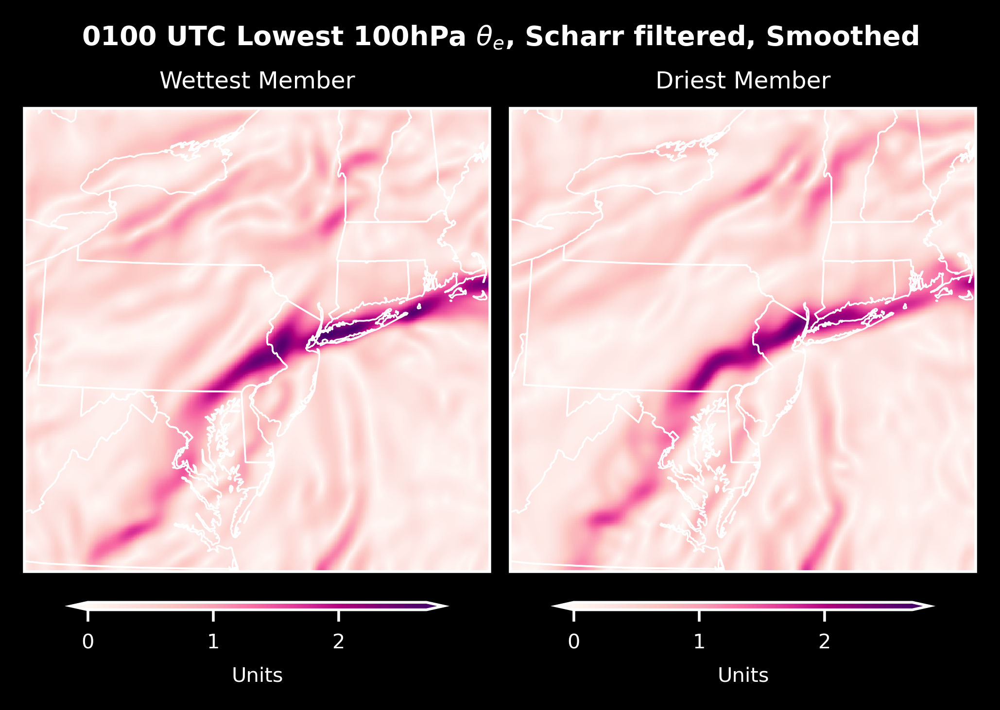

In [34]:
data = [thetae_wet_sch, thetae_dry_sch]
titles = ["Wettest Member", "Driest Member"]

# Increase the figure height to make more room vertically
fig, axes = plt.subplots(
    1,
    2,
    figsize=(4, 2.7),
    dpi=500,
    layout="constrained",
    subplot_kw=dict(projection=proj),
)

# Adjust the suptitle position to be higher up
fig.suptitle(
    r"0100 UTC Lowest 100hPa $\theta_{e}$, Scharr filtered, Smoothed", fontsize=8, y=1.02, fontweight="bold"
)

for i, ax in enumerate(axes.flat):
    if i < 2:
        cf = ax.pcolormesh(
            lon,
            lat,
            np.array(data[i]),
            transform=ccrs.PlateCarree(),
            vmin=0,
            vmax=2.7,
            cmap = "RdPu"
        )
    ax.set_extent(
        [
            -449900.09156094893,
            449900.51654555957,
            -447909.5438942791,
            448284.39736015256,
        ],
        crs=proj,
    )

    # Add state borders for each subplot
    ax.add_feature(cfeature.STATES, linewidth=0.5, edgecolor="white")

    cb = fig.colorbar(
        cf, ax=ax, orientation="horizontal", shrink=0.8, aspect=50, extend="both"
    )
    cb.ax.tick_params(labelsize=6)
    cb.set_label(r"Units", fontsize=6)

    ax.set_title(titles[i], fontsize=7)

plt.show()


### TFP

In [8]:
# Calculate the gradient of thetae_dry (returns two arrays: grad_x and grad_y)
grad_thetae_wet_x, grad_thetae_wet_y = gradient(smooth_gaussian(thetae_wet,n=30), deltas=(dy, dx))
grad_thetae_dry_x, grad_thetae_dry_y = gradient(smooth_gaussian(thetae_dry,n=30), deltas=(dy, dx))

# Calculate the gradient magnitude of thetae_wet
grad_thetae_wet_magnitude = np.sqrt(grad_thetae_wet_x**2 + grad_thetae_wet_y**2)
grad_thetae_dry_magnitude = np.sqrt(grad_thetae_dry_x**2 + grad_thetae_dry_y**2)

# Normalize to find component orthogonal to gradient
grad_thetae_wet_unit_x = grad_thetae_wet_x / grad_thetae_wet_magnitude
grad_thetae_wet_unit_y = grad_thetae_wet_y / grad_thetae_wet_magnitude
grad_thetae_dry_unit_x = grad_thetae_dry_x / grad_thetae_dry_magnitude
grad_thetae_dry_unit_y = grad_thetae_dry_y / grad_thetae_dry_magnitude

# Calculate the gradient of the gradient magnitude
grad_mag_wet_x, grad_mag_wet_y = gradient(grad_thetae_wet_magnitude, deltas=(dy, dx))
grad_mag_dry_x, grad_mag_dry_y = gradient(grad_thetae_dry_magnitude, deltas=(dy, dx))

# Calculate the TFP as the negative dot product of the gradients
tfp_wet = -(grad_thetae_wet_unit_x * grad_mag_wet_x + grad_thetae_wet_unit_y * grad_mag_wet_y)
tfp_dry = -(grad_thetae_dry_unit_x * grad_mag_dry_x + grad_thetae_dry_unit_y * grad_mag_dry_y)

print(tfp_wet.max().to("K/km/km") * 100)
print(abs(tfp_wet - tfp_dry).max().to("K/km/km") * 100)

1.7339381947114183 kelvin / kilometer ** 2
2.1787639636322966 kelvin / kilometer ** 2


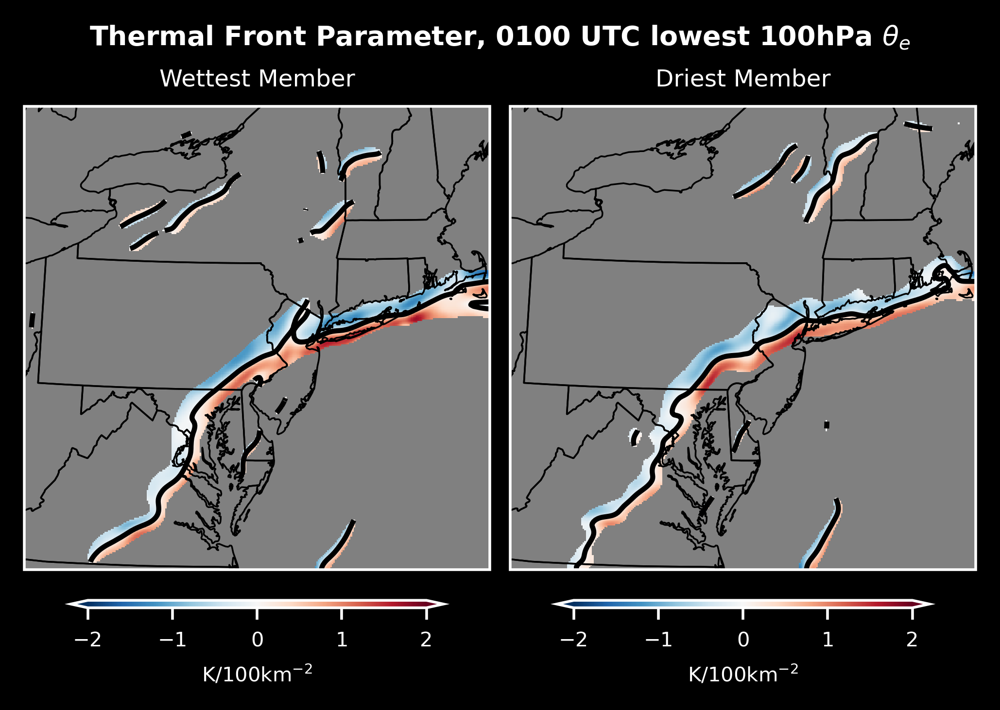

In [46]:
data = [tfp_wet, tfp_dry, tfp_wet - tfp_dry]
threshold = (17 * units.kelvin / units.km).to("K/m") / 100
masks = [
    grad_thetae_wet_magnitude > threshold,
    grad_thetae_dry_magnitude > threshold,
    (grad_thetae_dry_magnitude > threshold) & (grad_thetae_wet_magnitude > threshold),
]

titles = ["Wettest Member", "Driest Member", "Wettest-Driest"]

# Increase the figure height to make more room vertically
fig, axes = plt.subplots(
    1,
    2,
    figsize=(4, 2.7),  # Increased height from 3 to 4
    dpi=500,
    layout="constrained",
    subplot_kw=dict(projection=proj),
)

# Adjust the suptitle position to be higher up
fig.suptitle(
    r"Thermal Front Parameter, 0100 UTC lowest 100hPa $\theta_e$",
    fontsize=8,
    y=1.02,
    fontweight="bold",
)

# Create a colormap
cmap = plt.cm.RdBu_r

# Set the color for bad values
cmap.set_bad("gray")

for i, ax in enumerate(axes.flat):
    if i < 2:
        cf = ax.pcolormesh(
            lon,
            lat,
            np.where(masks[i], np.array(data[i].to("K/km/km") * 100), np.nan),
            transform=ccrs.PlateCarree(),
            vmin=-2,
            vmax=2,
            cmap=cmap,
        )
        c = ax.contour(
            lon,
            lat,
            np.where(masks[i], np.array(data[i].to("K/km/km") * 100), np.nan),
            # np.array(data[i].to("K/km/km") * 100),
            transform=ccrs.PlateCarree(),
            levels=[0],
            colors="black"
        )
    ax.set_extent(
        [
            -449900.09156094893,
            449900.51654555957,
            -447909.5438942791,
            448284.39736015256,
        ],
        crs=proj,
    )

    # Add state borders for each subplot
    ax.add_feature(cfeature.STATES, linewidth=0.5, edgecolor="black")

    cb = fig.colorbar(
        cf, ax=ax, orientation="horizontal", shrink=0.8, aspect=50, extend="both"
    )
    cb.ax.tick_params(labelsize=6)
    cb.set_label(r"K/100km$^{-2}$", fontsize=6)

    ax.set_title(titles[i], fontsize=7)

plt.show()


### Frontogenesis

In [8]:
def interp_and_sel(
    da: xr.DataArray, units: pint.Unit, proj: str, init: str, ne: int
) -> xr.DataArray:
    # Select one simulation because rio interpolation only works with 2D or 3D input
    da_2D = da.sel(init=init).isel(ne=ne)

    # Interpolate
    da_2D = (
        da_2D.rio.write_nodata(np.nan, inplace=True)
        .rio.set_spatial_dims(x_dim="lon", y_dim="lat", inplace=True)
        .rio.write_crs(proj)
        .rio.interpolate_na()
        * units
    )

    # Return
    return da_2D


In [9]:
# Read in 850mb temperature and dewpoint to calculate EPT
temperature_850 = (
    get_field(
        wofs_all, "temperature_850", "2021-09-02 01:00:00", "2021-09-02 01:00:00", init
    ).squeeze()
    * units.degC
)

td_850 = (
    get_field(
        wofs_all, "td_850", "2021-09-02 01:00:00", "2021-09-02 01:00:00", init
    ).squeeze()
    * units.degC
)

# Set pressure equal to 850mb
pressure = 850 * units.millibar

# Mask temperature values below the surface
temperature_850 = temperature_850.where(temperature_850 != 0 * units.degC)
td_850 = td_850.where(td_850 != 0 * units.degC)

# Calculate EPT
ept_850 = equivalent_potential_temperature(pressure, temperature_850, td_850)


In [11]:
# Read in winds, then fill in missing data prior to calculating frontogenesis
u850 = (
    get_field(
        wofs_all, "U_850", "2021-09-02 01:00:00", "2021-09-02 01:00:00", init
    ).squeeze() / 1.94384
    * units.meter_per_second
)

v850 = (
    get_field(
        wofs_all, "V_850", "2021-09-02 01:00:00", "2021-09-02 01:00:00", init
    ).squeeze() / 1.94384
    * units.meter_per_second
)

# Mask where winds are 0 (below the surface)
u850 = u850.where(u850 != 0 * units.meter_per_second)
v850 = v850.where(v850 != 0 * units.meter_per_second)

# Define our projection
lcc_proj = (
    "+proj=lcc +lat_1=30.0 +lat_2=60.0 +lat_0=40.650017 +lon_0=-75.42999 "
    "+x_0=0 +y_0=0 +datum=WGS84 +units=m +no_defs"
)

# We have to smooth our data for sure because frontogenesis is messy
sigma = 30

# Get wettest and driest simulations
ept_850_wet = smooth_gaussian(
    interp_and_sel(ept_850, units.kelvin, lcc_proj, "23Z", 16), n=sigma
)
ept_850_dry = smooth_gaussian(
    interp_and_sel(ept_850, units.kelvin, lcc_proj, "20Z", 10), n=sigma
)

u850_wet = smooth_gaussian(
    interp_and_sel(u850, units.meter_per_second, lcc_proj, "23Z", 16), n=sigma
)
u850_dry = smooth_gaussian(
    interp_and_sel(u850, units.meter_per_second, lcc_proj, "20Z", 10), n=sigma
)

v850_wet = smooth_gaussian(
    interp_and_sel(v850, units.meter_per_second, lcc_proj, "23Z", 16), n=sigma
)
v850_dry = smooth_gaussian(
    interp_and_sel(v850, units.meter_per_second, lcc_proj, "20Z", 10), n=sigma
)

# Define deltas
dx = 3 * 1000 * units.meter
dy = 3 * 1000 * units.meter

# Calculate frontogenesis
fg_wet = frontogenesis(
    ept_850_wet, u850_wet, v850_wet, dx=dx, dy=dy, x_dim=-1, y_dim=-2
)
fg_dry = frontogenesis(
    ept_850_dry, u850_dry, v850_dry, dx=dx, dy=dy, x_dim=-1, y_dim=-2
)


/tmp/ipykernel_3620187/183395520.py:56: UserWarning: Horizontal dimension numbers not found. Defaulting to (..., Y, X) order.
  fg_wet = frontogenesis(
/tmp/ipykernel_3620187/183395520.py:59: UserWarning: Horizontal dimension numbers not found. Defaulting to (..., Y, X) order.
  fg_dry = frontogenesis(


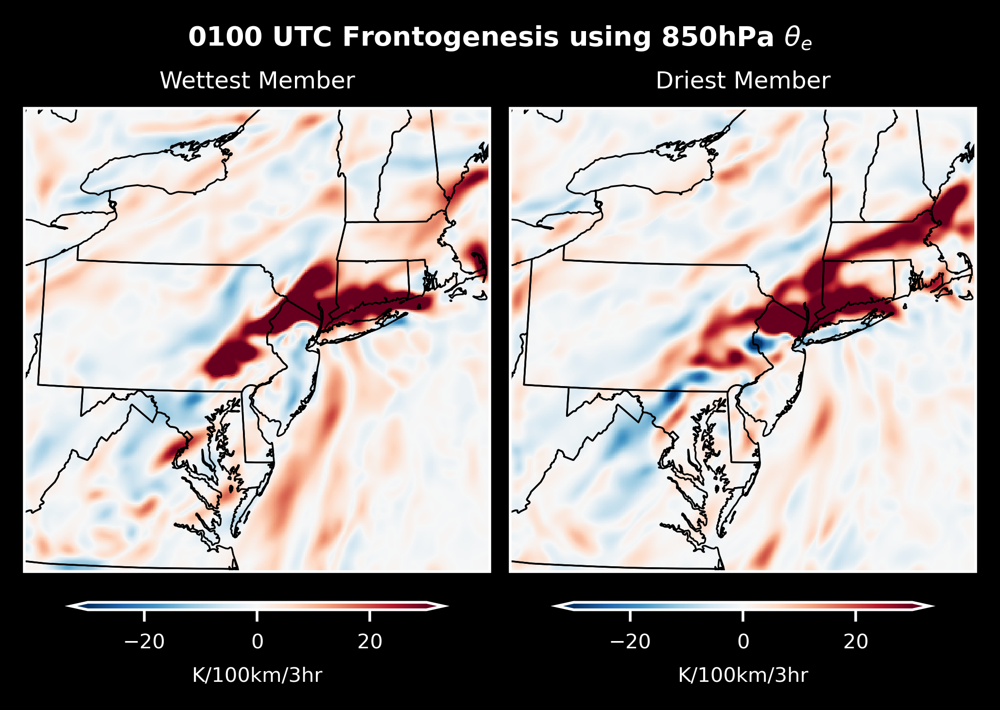

In [ ]:
data = [fg_wet, fg_dry]
# threshold = (30 * units.kelvin / units.km).to("K/m") / 100
# masks = [
#     grad_thetae_wet_magnitude > threshold,
#     grad_thetae_dry_magnitude > threshold,
#     (grad_thetae_dry_magnitude > threshold) & (grad_thetae_wet_magnitude > threshold),
# ]

titles = ["Wettest Member", "Driest Member"]

# Increase the figure height to make more room vertically
fig, axes = plt.subplots(
    1,
    2,
    figsize=(4, 2.7),
    dpi=500,
    layout="constrained",
    subplot_kw=dict(projection=proj),
)


# Adjust the suptitle position to be higher up
fig.suptitle(
    r"0100 UTC Frontogenesis using 850hPa $\theta_e$",
    fontsize=8,
    y=1.02,
    fontweight="bold",
)

# Create a colormap
cmap = plt.cm.RdBu_r

# Set the color for bad values
cmap.set_bad("gray")

for i, ax in enumerate(axes.flat):
    if i < 2:
        cf = ax.pcolormesh(
            lon,
            lat,
            # np.where(masks[i], np.array(data[i].to("K/km/km") * 100), np.nan),
            data[i] * 1.08e9,
            transform=ccrs.PlateCarree(),
            vmin=-30,
            vmax=30,
            cmap=cmap,
        )
    ax.set_extent(
        [
            -449900.09156094893,
            449900.51654555957,
            -447909.5438942791,
            448284.39736015256,
        ],
        crs=proj,
    )

    # Add state borders for each subplot
    ax.add_feature(cfeature.STATES, linewidth=0.5, edgecolor="black")

    cb = fig.colorbar(
        cf, ax=ax, orientation="horizontal", shrink=0.8, aspect=50, extend="both"
    )
    cb.ax.tick_params(labelsize=6)
    cb.set_label(r"K/100km/3hr", fontsize=6)

    ax.set_title(titles[i], fontsize=7)

plt.show()


## Theta

In [17]:
def interp_and_sel(
    da: xr.DataArray, units: pint.Unit, proj: str, init: str, ne: int
) -> xr.DataArray:
    # Select one simulation because rio interpolation only works with 2D or 3D input
    da_2D = da.sel(init=init).isel(ne=ne)

    # Interpolate
    da_2D = (
        da_2D.rio.write_nodata(np.nan, inplace=True)
        .rio.set_spatial_dims(x_dim="lon", y_dim="lat", inplace=True)
        .rio.write_crs(proj)
        .rio.interpolate_na()
        * units
    )

    # Return
    return da_2D


In [18]:
# grab 850mb temperature and pressure
temperature_850 = get_field(
    wofs_all, "temperature_850", "2021-09-02 01:00:00", "2021-09-02 01:00:00", init
).squeeze() * units.degC

# mask where the 850mb temperature is 0 (it means it's below the surface)
temperature_850 = temperature_850.where(temperature_850!=0*units.degC)

pressure = 850 * units.millibar

# # Calculate potential temperature
θ850 = potential_temperature(pressure, temperature_850)

# get wet/dry
θ850_wet = θ850.sel(init="23Z").isel(ne=10).squeeze()
θ850_dry = θ850.sel(init="20Z").isel(ne=16).squeeze()

# get deltas
dx = 3 * 1000 * units.meter
dy = 3 * 1000  * units.meter

In [19]:
# Issue: we don't NaNs to propagate as we smooth or take derivatives
# What we can do is fill missing values with a simple biliear interpolation from surrounding points

# Set our projection
lcc_proj = (
    "+proj=lcc +lat_1=30.0 +lat_2=60.0 +lat_0=40.650017 +lon_0=-75.42999 "
    "+x_0=0 +y_0=0 +datum=WGS84 +units=m +no_defs"
)

θ850_wet = (
    θ850_wet.rio.write_nodata(np.nan, inplace=True)
    .rio.set_spatial_dims(x_dim="lon", y_dim="lat", inplace=True)
    .rio.write_crs(lcc_proj)
    .rio.interpolate_na()
)

θ850_dry = (
    θ850_dry.rio.write_nodata(np.nan, inplace=True)
    .rio.set_spatial_dims(x_dim="lon", y_dim="lat", inplace=True)
    .rio.write_crs(lcc_proj)
    .rio.interpolate_na()
)

### Gradient of temperature

#### Unsmoothed

In [ ]:
# calculate gradient
grad_θ850_wet = gradient(θ850_wet * units.kelvin,deltas=(dy,dx))
grad_θ850_dry = gradient(θ850_dry * units.kelvin,deltas=(dy,dx))

# magnitude of gradient
mag_grad_wet = np.sqrt(grad_θ850_wet[0]**2 + grad_θ850_wet[1]**2)
mag_grad_dry = np.sqrt(grad_θ850_dry[0]**2 + grad_θ850_dry[1]**2)


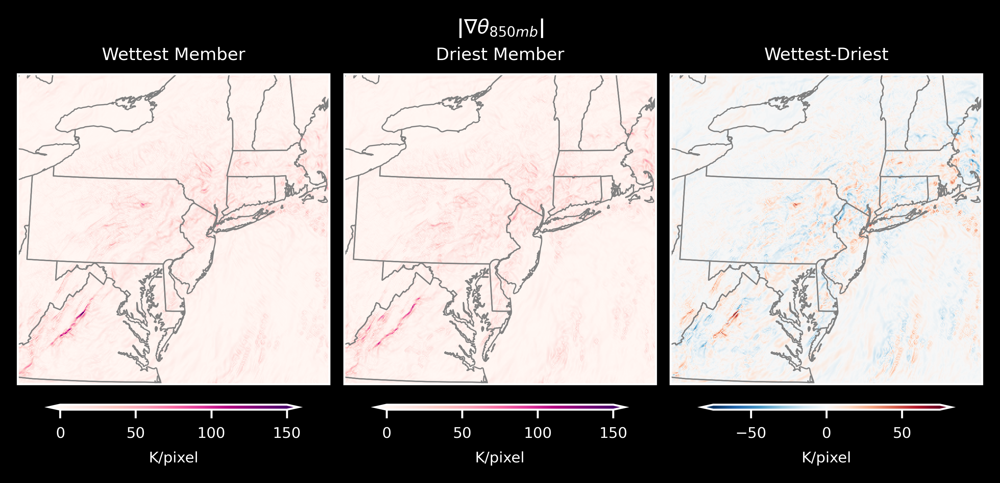

In [126]:
data = [mag_grad_wet, mag_grad_dry, mag_grad_wet - mag_grad_dry]
titles = ["Wettest Member", "Driest Member", "Wettest-Driest"]

# Increase the figure height to make more room vertically
fig, axes = plt.subplots(
    1,
    3,
    figsize=(5.5, 2.5),  # Increased height from 3 to 4
    dpi=500,
    layout="constrained",
    subplot_kw=dict(projection=proj),
)

# Adjust the suptitle position to be higher up
fig.suptitle(
    r"|$\nabla \theta_{850mb}$|", fontsize=8, y=1.02, fontweight="bold"
)

for i, ax in enumerate(axes.flat):
    if i < 2:
        cf = ax.pcolormesh(
            lon,
            lat,
            np.array(data[i].to("K/km") * 100),
            transform=ccrs.PlateCarree(),
            vmin=0,
            vmax=150,
            cmap = "RdPu"
        )
    else:
        cf = ax.pcolormesh(
            lon,
            lat,
            np.array(data[i].to("K/km") * 100),
            transform=ccrs.PlateCarree(),
            vmin=-75,
            vmax=75,
            cmap="RdBu_r",
        )
    ax.set_extent(
        [
            -449900.09156094893,
            449900.51654555957,
            -447909.5438942791,
            448284.39736015256,
        ],
        crs=proj,
    )

    # Add state borders for each subplot
    ax.add_feature(cfeature.STATES, linewidth=0.5, edgecolor="gray")

    cb = fig.colorbar(
        cf, ax=ax, orientation="horizontal", shrink=0.8, aspect=50, extend="both"
    )
    cb.ax.tick_params(labelsize=6)
    cb.set_label(r"K/pixel", fontsize=6)

    ax.set_title(titles[i], fontsize=7)

plt.show()


#### Smoothed

In [17]:
# set smoothing sigma
sigma = 30

# calculate gradient
grad_θ850_wet = gradient(smooth_gaussian(θ850_wet,n=sigma) * units.kelvin,deltas=(dy,dx))
grad_θ850_dry = gradient(smooth_gaussian(θ850_dry,n=sigma) * units.kelvin,deltas=(dy,dx))

# magnitude of gradient
mag_grad_wet = np.sqrt(grad_θ850_wet[0]**2 + grad_θ850_wet[1]**2)
mag_grad_dry = np.sqrt(grad_θ850_dry[0]**2 + grad_θ850_dry[1]**2)

print(((mag_grad_wet-mag_grad_dry).to("K/km")*100).max())


6.531201621319652 kelvin / kilometer


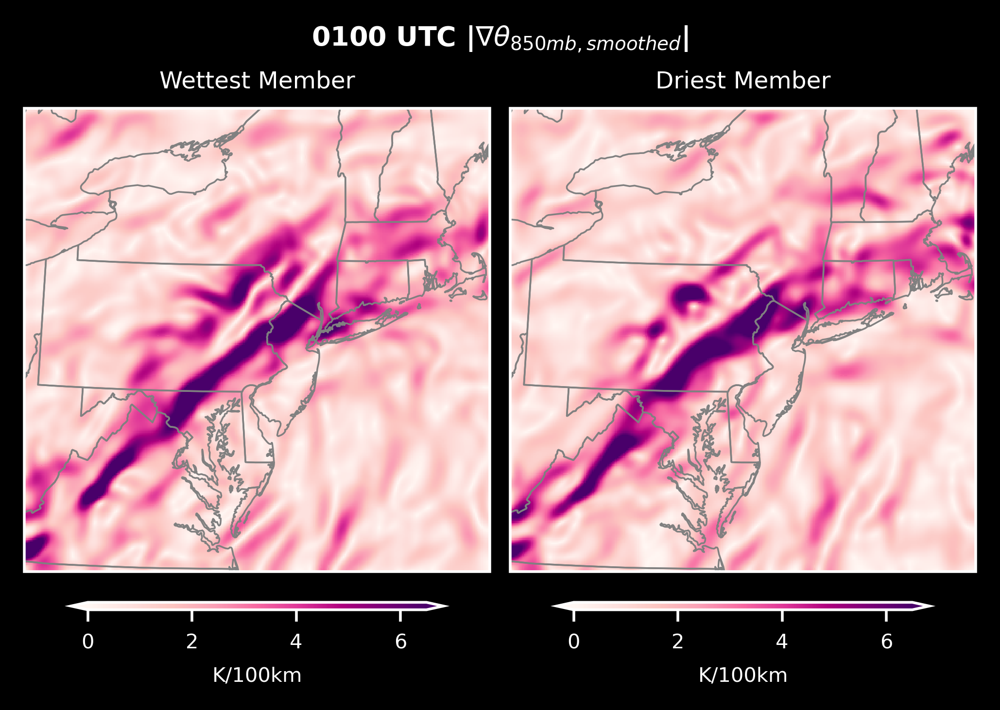

In [21]:
data = [mag_grad_wet, mag_grad_dry]
titles = ["Wettest Member", "Driest Member"]

# Increase the figure height to make more room vertically
fig, axes = plt.subplots(
    1,
    2,
    figsize=(4, 2.7),
    dpi=500,
    layout="constrained",
    subplot_kw=dict(projection=proj),
)

# Adjust the suptitle position to be higher up
fig.suptitle(
    r"0100 UTC |$\nabla \theta_{850mb,smoothed}$|", fontsize=8, y=1.02, fontweight="bold"
)

for i, ax in enumerate(axes.flat):
    if i < 2:
        cf = ax.pcolormesh(
            lon,
            lat,
            np.array(data[i].to("K/km") * 100),
            transform=ccrs.PlateCarree(),
            vmin=0,
            vmax=6.5,
            cmap = "RdPu"
        )
    ax.set_extent(
        [
            -449900.09156094893,
            449900.51654555957,
            -447909.5438942791,
            448284.39736015256,
        ],
        crs=proj,
    )

    # Add state borders for each subplot
    ax.add_feature(cfeature.STATES, linewidth=0.5, edgecolor="gray")

    cb = fig.colorbar(
        cf, ax=ax, orientation="horizontal", shrink=0.8, aspect=50, extend="both"
    )
    cb.ax.tick_params(labelsize=6)
    cb.set_label(r"K/100km", fontsize=6)

    ax.set_title(titles[i], fontsize=7)

plt.show()


### TFP

#### Unsmoothed

In [ ]:
# Calculate the gradient of θ850_dry (returns two arrays: grad_y and grad_x due to (lat, lon) order)
grad_θ850_wet_y, grad_θ850_wet_x = gradient(θ850_wet * units.kelvin, deltas=(dy, dx))
grad_θ850_dry_y, grad_θ850_dry_x = gradient(θ850_dry * units.kelvin, deltas=(dy, dx))

# Calculate the gradient magnitude of θ850_wet
grad_θ850_wet_magnitude = np.sqrt(grad_θ850_wet_x**2 + grad_θ850_wet_y**2)
grad_θ850_dry_magnitude = np.sqrt(grad_θ850_dry_x**2 + grad_θ850_dry_y**2)

# Normalize to find component orthogonal to gradient
grad_θ850_wet_unit_x = grad_θ850_wet_x / grad_θ850_wet_magnitude
grad_θ850_wet_unit_y = grad_θ850_wet_y / grad_θ850_wet_magnitude
grad_θ850_dry_unit_x = grad_θ850_dry_x / grad_θ850_dry_magnitude
grad_θ850_dry_unit_y = grad_θ850_dry_y / grad_θ850_dry_magnitude

# Calculate the gradient of the gradient magnitude
grad_mag_wet_y, grad_mag_wet_x = gradient(grad_θ850_wet_magnitude, deltas=(dy, dx))
grad_mag_dry_y, grad_mag_dry_x = gradient(grad_θ850_dry_magnitude, deltas=(dy, dx))

# Calculate the TFP as the negative dot product of the gradients
tfp_wet = -(
    grad_θ850_wet_unit_x * grad_mag_wet_x + grad_θ850_wet_unit_y * grad_mag_wet_y
)
tfp_dry = -(
    grad_θ850_dry_unit_x * grad_mag_dry_x + grad_θ850_dry_unit_y * grad_mag_dry_y
)

# Convert TFP to desired units and print max value
print(np.nan_to_num(tfp_wet.to("K/km/km") * 100 * 100).max())


3098.4149682073516 kelvin / kilometer ** 2


/home/janoski/miniforge3/envs/wof/lib/python3.12/site-packages/pint/facets/plain/quantity.py:1006: RuntimeWarning: invalid value encountered in divide
  magnitude = magnitude_op(new_self._magnitude, other._magnitude)


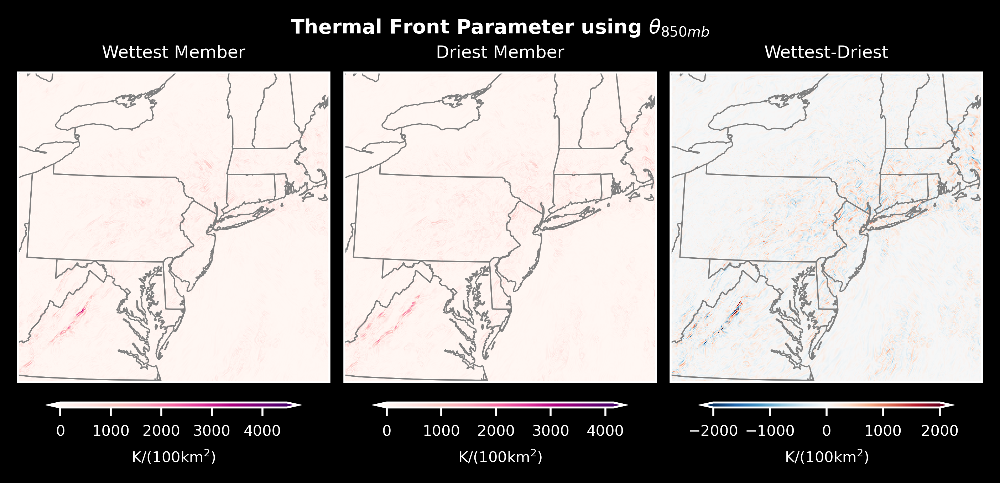

In [170]:
data = [tfp_wet, tfp_dry, tfp_wet - tfp_dry]
titles = ["Wettest Member", "Driest Member", "Wettest-Driest"]

# Increase the figure height to make more room vertically
fig, axes = plt.subplots(
    1,
    3,
    figsize=(5.5, 2.5),  # Increased height from 3 to 4
    dpi=500,
    layout="constrained",
    subplot_kw=dict(projection=proj),
)

# Adjust the suptitle position to be higher up
fig.suptitle(
    r"Thermal Front Parameter using $\theta_{850mb}$",
    fontsize=8,
    y=1.02,
    fontweight="bold",
)

for i, ax in enumerate(axes.flat):
    if i < 2:
        cf = ax.pcolormesh(
            lon,
            lat,
            np.array(abs(np.nan_to_num(data[i])).to("K/km/km") * 100 * 100),
            transform=ccrs.PlateCarree(),
            # vmin=0,
            # vmax=150,
            cmap="RdPu",
        )
    else:
        cf = ax.pcolormesh(
            lon,
            lat,
            np.array(np.nan_to_num(data[i]).to("K/km/km") * 100 * 100),
            transform=ccrs.PlateCarree(),
            vmin=-2000,
            vmax=2000,
            cmap="RdBu_r",
        )
    ax.set_extent(
        [
            -449900.09156094893,
            449900.51654555957,
            -447909.5438942791,
            448284.39736015256,
        ],
        crs=proj,
    )

    # Add state borders for each subplot
    ax.add_feature(cfeature.STATES, linewidth=0.5, edgecolor="gray")

    cb = fig.colorbar(
        cf, ax=ax, orientation="horizontal", shrink=0.8, aspect=50, extend="both"
    )
    cb.ax.tick_params(labelsize=6)
    cb.set_label(r"K/(100km$^2$)", fontsize=6)

    ax.set_title(titles[i], fontsize=7)

plt.show()


#### Smoothed

In [22]:
sigma = 30

# Calculate the gradient of θ850_dry (returns two arrays: grad_y and grad_x due to (lat, lon) order)
grad_θ850_wet_y, grad_θ850_wet_x = gradient(smooth_gaussian(θ850_wet,n=sigma) * units.kelvin, deltas=(dy, dx))
grad_θ850_dry_y, grad_θ850_dry_x = gradient(smooth_gaussian(θ850_dry,n=sigma) * units.kelvin, deltas=(dy, dx))

# Calculate the gradient magnitude of θ850_wet
grad_θ850_wet_magnitude = np.sqrt(grad_θ850_wet_x**2 + grad_θ850_wet_y**2)
grad_θ850_dry_magnitude = np.sqrt(grad_θ850_dry_x**2 + grad_θ850_dry_y**2)

# Normalize to find component orthogonal to gradient
grad_θ850_wet_unit_x = grad_θ850_wet_x / grad_θ850_wet_magnitude
grad_θ850_wet_unit_y = grad_θ850_wet_y / grad_θ850_wet_magnitude
grad_θ850_dry_unit_x = grad_θ850_dry_x / grad_θ850_dry_magnitude
grad_θ850_dry_unit_y = grad_θ850_dry_y / grad_θ850_dry_magnitude

# Calculate the gradient of the gradient magnitude
grad_mag_wet_y, grad_mag_wet_x = gradient(grad_θ850_wet_magnitude, deltas=(dy, dx))
grad_mag_dry_y, grad_mag_dry_x = gradient(grad_θ850_dry_magnitude, deltas=(dy, dx))

# Calculate the TFP as the negative dot product of the gradients
tfp_wet = -(
    grad_θ850_wet_unit_x * grad_mag_wet_x + grad_θ850_wet_unit_y * grad_mag_wet_y
)
tfp_dry = -(
    grad_θ850_dry_unit_x * grad_mag_dry_x + grad_θ850_dry_unit_y * grad_mag_dry_y
)

# Convert TFP to desired units and print max value
print(np.nan_to_num(tfp_wet.to("K/km/km") * 100 * 100).max())


52.866480959618855 kelvin / kilometer ** 2


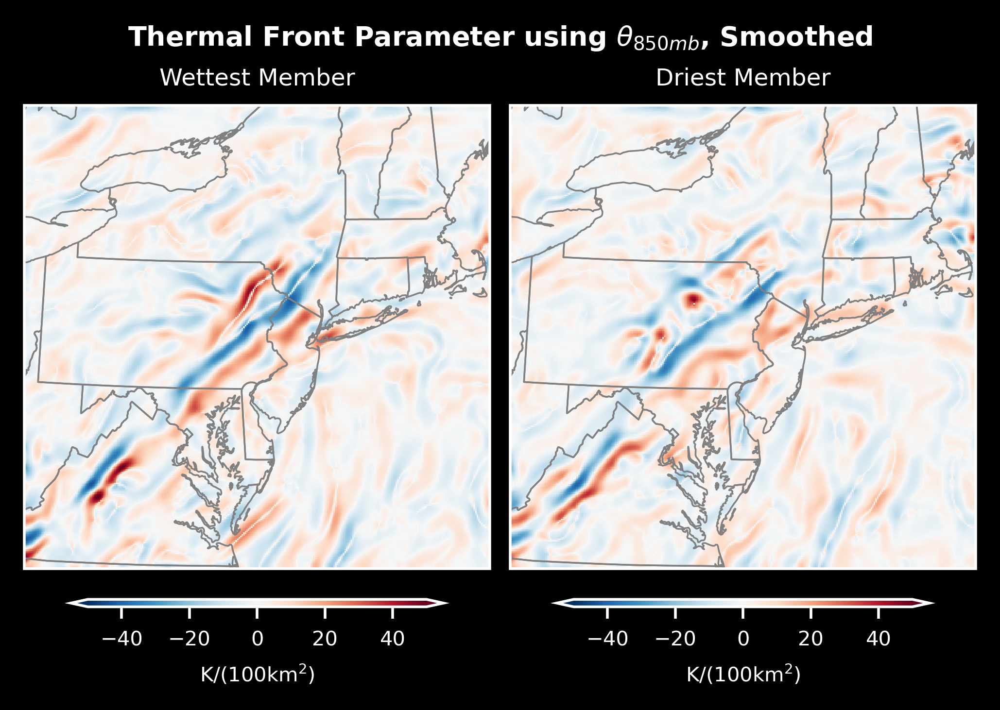

In [23]:
data = [tfp_wet, tfp_dry]
titles = ["Wettest Member", "Driest Member", "Wettest-Driest"]

# Increase the figure height to make more room vertically
fig, axes = plt.subplots(
    1,
    2,
    figsize=(4, 2.7),
    dpi=500,
    layout="constrained",
    subplot_kw=dict(projection=proj),
)

# Adjust the suptitle position to be higher up
fig.suptitle(
    r"Thermal Front Parameter using $\theta_{850mb}$, Smoothed",
    fontsize=8,
    y=1.02,
    fontweight="bold",
)

for i, ax in enumerate(axes.flat):
    if i < 2:
        cf = ax.pcolormesh(
            lon,
            lat,
            np.array(np.nan_to_num(data[i]).to("K/km/km") * 100 * 100),
            transform=ccrs.PlateCarree(),
            vmin=-50,
            vmax=50,
            cmap="RdBu_r",
        )
    ax.set_extent(
        [
            -449900.09156094893,
            449900.51654555957,
            -447909.5438942791,
            448284.39736015256,
        ],
        crs=proj,
    )

    # Add state borders for each subplot
    ax.add_feature(cfeature.STATES, linewidth=0.5, edgecolor="gray")

    cb = fig.colorbar(
        cf, ax=ax, orientation="horizontal", shrink=0.8, aspect=50, extend="both"
    )
    cb.ax.tick_params(labelsize=6)
    cb.set_label(r"K/(100km$^2$)", fontsize=6)

    ax.set_title(titles[i], fontsize=7)

plt.show()


### Scharr filter

#### Unsmoothed

In [15]:
# Apply sobel filter
θ850_wet_sob = np.sqrt(sobel(θ850_wet,axis=0)**2 + sobel(θ850_wet,axis=1)**2)
θ850_dry_sob = np.sqrt(sobel(θ850_dry,axis=0)**2 + sobel(θ850_dry,axis=1)**2)

print(θ850_wet_sob.max())
print(θ850_dry_sob.max())
print(abs(θ850_wet_sob - θ850_dry_sob).max())

29.397127815734667
20.43590065632009
14.943156890224556


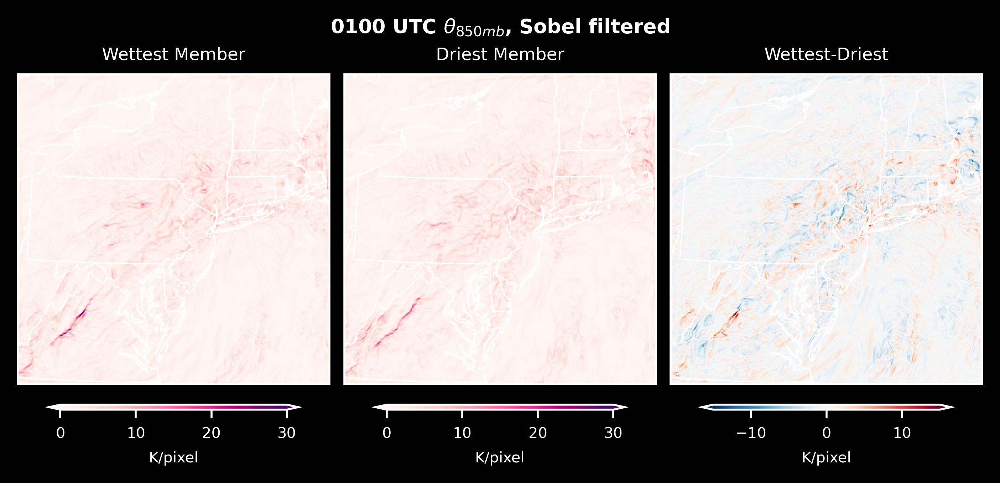

In [16]:
data = [θ850_wet_sob, θ850_dry_sob, θ850_wet_sob - θ850_dry_sob]
titles = ["Wettest Member", "Driest Member", "Wettest-Driest"]

# Increase the figure height to make more room vertically
fig, axes = plt.subplots(
    1,
    3,
    figsize=(5.5, 2.5),  # Increased height from 3 to 4
    dpi=500,
    layout="constrained",
    subplot_kw=dict(projection=proj),
)

# Adjust the suptitle position to be higher up
fig.suptitle(
    r"0100 UTC $\theta_{850mb}$, Sobel filtered", fontsize=8, y=1.02, fontweight="bold"
)

for i, ax in enumerate(axes.flat):
    if i < 2:
        cf = ax.pcolormesh(
            lon,
            lat,
            np.array(data[i]),
            transform=ccrs.PlateCarree(),
            vmin=0,
            vmax=30,
            cmap = "RdPu"
        )
    else:
        cf = ax.pcolormesh(
            lon,
            lat,
            np.array(data[i]),
            transform=ccrs.PlateCarree(),
            vmin=-15,
            vmax=15,
            cmap="RdBu_r",
        )
    ax.set_extent(
        [
            -449900.09156094893,
            449900.51654555957,
            -447909.5438942791,
            448284.39736015256,
        ],
        crs=proj,
    )

    # Add state borders for each subplot
    ax.add_feature(cfeature.STATES, linewidth=0.5, edgecolor="white")

    cb = fig.colorbar(
        cf, ax=ax, orientation="horizontal", shrink=0.8, aspect=50, extend="both"
    )
    cb.ax.tick_params(labelsize=6)
    cb.set_label(r"K/pixel", fontsize=6)

    ax.set_title(titles[i], fontsize=7)

plt.show()


#### Smoothed

In [24]:
θ850_wet_sch = np.sqrt(scharr(smooth_gaussian(θ850_wet,n=30),axis=0)**2 + scharr(smooth_gaussian(θ850_wet,n=30),axis=1)**2)
θ850_dry_sch = np.sqrt(scharr(smooth_gaussian(θ850_dry,n=30),axis=0)**2 + scharr(smooth_gaussian(θ850_dry,n=30),axis=1)**2)

print(θ850_wet_sch.max())

0.6270884106886991


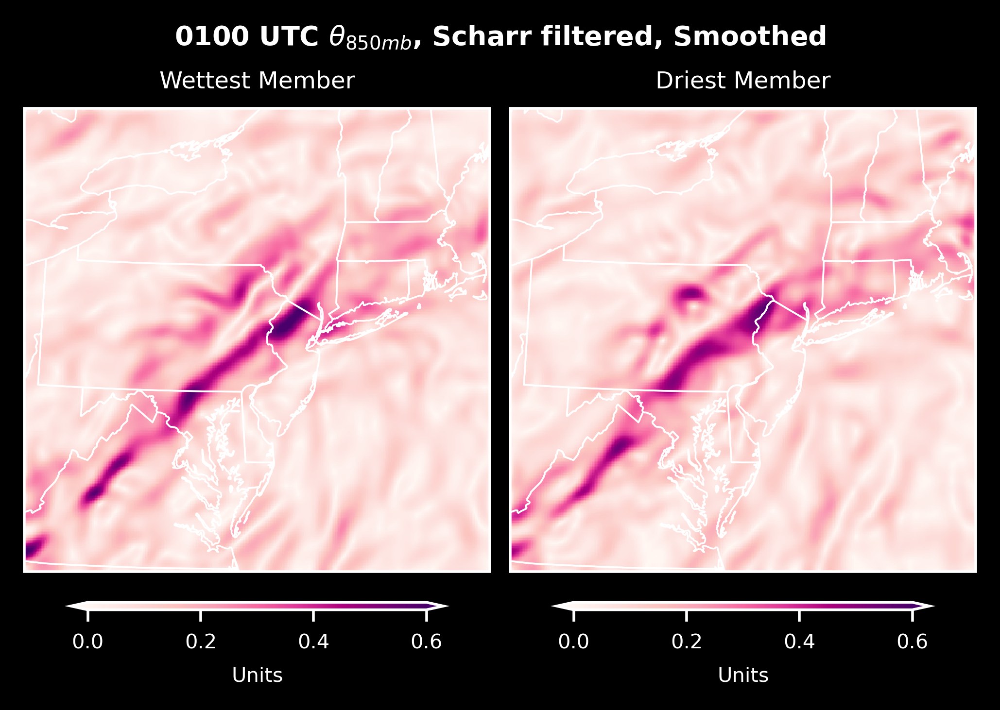

In [25]:
data = [θ850_wet_sch, θ850_dry_sch]
titles = ["Wettest Member", "Driest Member"]

# Increase the figure height to make more room vertically
fig, axes = plt.subplots(
    1,
    2,
    figsize=(4, 2.7),
    dpi=500,
    layout="constrained",
    subplot_kw=dict(projection=proj),
)

# Adjust the suptitle position to be higher up
fig.suptitle(
    r"0100 UTC $\theta_{850mb}$, Scharr filtered, Smoothed", fontsize=8, y=1.02, fontweight="bold"
)

for i, ax in enumerate(axes.flat):
    if i < 2:
        cf = ax.pcolormesh(
            lon,
            lat,
            np.array(data[i]),
            transform=ccrs.PlateCarree(),
            vmin=0,
            vmax=0.6,
            cmap = "RdPu"
        )
    ax.set_extent(
        [
            -449900.09156094893,
            449900.51654555957,
            -447909.5438942791,
            448284.39736015256,
        ],
        crs=proj,
    )

    # Add state borders for each subplot
    ax.add_feature(cfeature.STATES, linewidth=0.5, edgecolor="white")

    cb = fig.colorbar(
        cf, ax=ax, orientation="horizontal", shrink=0.8, aspect=50, extend="both"
    )
    cb.ax.tick_params(labelsize=6)
    cb.set_label(r"Units", fontsize=6)

    ax.set_title(titles[i], fontsize=7)

plt.show()


##### Hough transform

In [26]:
# Set edge threshold, find values that exceed it
thresh_wet = np.percentile(θ850_wet_sch, 95)
edge_wet = θ850_wet_sch > thresh_wet

thresh_dry = np.percentile(θ850_dry_sch, 95)
edge_dry = θ850_dry_sch > thresh_dry

# Apply Hough Transform
h_wet, theta_wet, d_wet = transform.hough_line(edge_wet)
h_dry, theta_dry, d_dry = transform.hough_line(edge_dry)

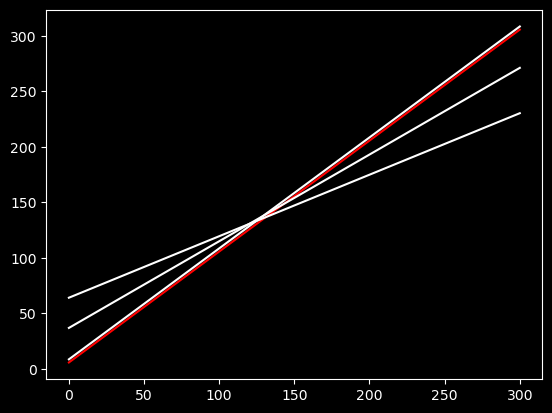

In [29]:
for _, angle_wet, dist_wet in zip(*transform.hough_line_peaks(h_wet, theta_wet, d_wet)):
    # Convert polar coordinates to Cartesian coordinates for line plotting
    y0 = (dist_wet - 0 * np.cos(angle_wet)) / np.sin(angle_wet)
    y1 = (dist_wet - edge_wet.shape[1] * np.cos(angle_wet)) / np.sin(angle_wet)
    plt.plot((0,edge_wet.shape[0]),(y0,y1),"-r")

for _, angle_dry, dist_dry in zip(*transform.hough_line_peaks(h_dry, theta_dry, d_dry)):
    # Convert polar coordinates to Cartesian coordinates for line plotting
    y0 = (dist_dry - 0 * np.cos(angle_dry)) / np.sin(angle_dry)
    y1 = (dist_dry - edge_dry.shape[1] * np.cos(angle_dry)) / np.sin(angle_dry)
    plt.plot((0,edge_dry.shape[0]),(y0,y1),"-w")

### Frontogenesis

In [21]:
# Read in winds, then fill in missing data prior to calculating frontogenesis
u850 = (
    get_field(
        wofs_all, "U_850", "2021-09-02 01:00:00", "2021-09-02 01:00:00", init
    ).squeeze()
    / 1.94384
    * units.meter_per_second
)

v850 = (
    get_field(
        wofs_all, "V_850", "2021-09-02 01:00:00", "2021-09-02 01:00:00", init
    ).squeeze()
    / 1.94384
    * units.meter_per_second
)

# Mask where winds are 0 (below the surface)
u850 = u850.where(u850 != 0 * units.meter_per_second)
v850 = v850.where(v850 != 0 * units.meter_per_second)

# Define our projection
lcc_proj = (
    "+proj=lcc +lat_1=30.0 +lat_2=60.0 +lat_0=40.650017 +lon_0=-75.42999 "
    "+x_0=0 +y_0=0 +datum=WGS84 +units=m +no_defs"
)

# We have to smooth our data for sure because frontogenesis is messy
sigma = 30

# Get wettest and driest simulations
θ850_wet = smooth_gaussian(
    interp_and_sel(θ850, units.kelvin, lcc_proj, "23Z", 16), n=sigma
)
θ850_dry = smooth_gaussian(
    interp_and_sel(θ850, units.kelvin, lcc_proj, "20Z", 10), n=sigma
)

u850_wet = smooth_gaussian(
    interp_and_sel(u850, units.meter_per_second, lcc_proj, "23Z", 16), n=sigma
)
u850_dry = smooth_gaussian(
    interp_and_sel(u850, units.meter_per_second, lcc_proj, "20Z", 10), n=sigma
)

v850_wet = smooth_gaussian(
    interp_and_sel(v850, units.meter_per_second, lcc_proj, "23Z", 16), n=sigma
)
v850_dry = smooth_gaussian(
    interp_and_sel(v850, units.meter_per_second, lcc_proj, "20Z", 10), n=sigma
)

# Calculate frontogenesis
fg_wet = frontogenesis(
    θ850_wet, u850_wet, v850_wet, dx=dx, dy=dy, x_dim=-1, y_dim=-2
)
fg_dry = frontogenesis(
    θ850_dry, u850_dry, v850_dry, dx=dx, dy=dy, x_dim=-1, y_dim=-2
)

/tmp/ipykernel_3671081/2479863454.py:54: UserWarning: Horizontal dimension numbers not found. Defaulting to (..., Y, X) order.
  fg_wet = frontogenesis(
/tmp/ipykernel_3671081/2479863454.py:57: UserWarning: Horizontal dimension numbers not found. Defaulting to (..., Y, X) order.
  fg_dry = frontogenesis(


In [23]:
(fg_wet*1.08e9).max()

<xarray.DataArray ()> Size: 8B
<Quantity(49.944733, 'kelvin * meter_per_second / meter ** 2')>
Coordinates:
    time         object 8B 2021-09-02 01:00:00
    init         <U3 12B '23Z'
    spatial_ref  int64 8B 0

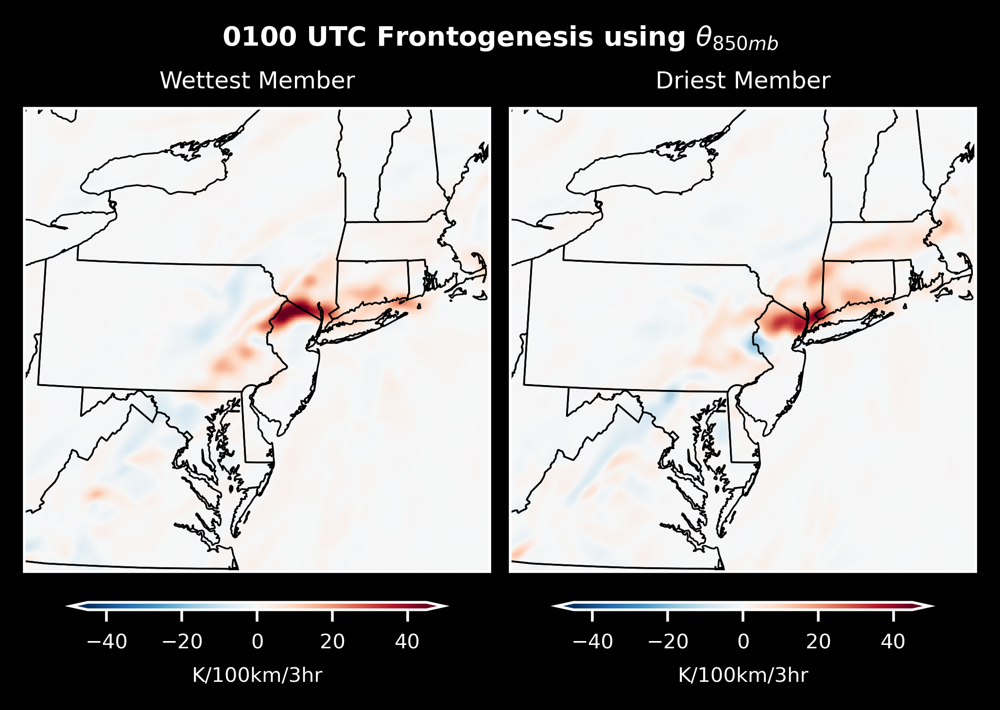

In [24]:
data = [fg_wet, fg_dry]
# threshold = (30 * units.kelvin / units.km).to("K/m") / 100
# masks = [
#     grad_thetae_wet_magnitude > threshold,
#     grad_thetae_dry_magnitude > threshold,
#     (grad_thetae_dry_magnitude > threshold) & (grad_thetae_wet_magnitude > threshold),
# ]

titles = ["Wettest Member", "Driest Member"]

# Increase the figure height to make more room vertically
fig, axes = plt.subplots(
    1,
    2,
    figsize=(4, 2.7),
    dpi=500,
    layout="constrained",
    subplot_kw=dict(projection=proj),
)


# Adjust the suptitle position to be higher up
fig.suptitle(
    r"0100 UTC Frontogenesis using $\theta_{850mb}$",
    fontsize=8,
    y=1.02,
    fontweight="bold",
)

# Create a colormap
cmap = plt.cm.RdBu_r

# Set the color for bad values
cmap.set_bad("gray")

for i, ax in enumerate(axes.flat):
    if i < 2:
        cf = ax.pcolormesh(
            lon,
            lat,
            # np.where(masks[i], np.array(data[i].to("K/km/km") * 100), np.nan),
            data[i] * 1.08e9,
            transform=ccrs.PlateCarree(),
            vmin=-45,
            vmax=45,
            cmap=cmap,
        )
    ax.set_extent(
        [
            -449900.09156094893,
            449900.51654555957,
            -447909.5438942791,
            448284.39736015256,
        ],
        crs=proj,
    )

    # Add state borders for each subplot
    ax.add_feature(cfeature.STATES, linewidth=0.5, edgecolor="black")

    cb = fig.colorbar(
        cf, ax=ax, orientation="horizontal", shrink=0.8, aspect=50, extend="both"
    )
    cb.ax.tick_params(labelsize=6)
    cb.set_label(r"K/100km/3hr", fontsize=6)

    ax.set_title(titles[i], fontsize=7)

plt.show()


## Apply to all ensemble members

In [8]:
# Get the wet and dry ensembles thetae fields

thetae_wet = get_field(
    wofs_wet, "theta_e", "2021-09-02 01:00:00", "2021-09-02 01:00:00", init
).squeeze().stack(run=("init","ne")).transpose("run","lat","lon")
thetae_dry = get_field(
    wofs_dry, "theta_e", "2021-09-02 01:00:00", "2021-09-02 01:00:00", init
).squeeze().stack(run=("init","ne")).transpose("run","lat","lon")

In [ ]:
# Calculate the gradient of thetae_dry (returns two arrays: grad_x and grad_y)
grad_thetae_wet_y, grad_thetae_wet_x = gradient(
    smooth_gaussian(thetae_wet, n=30), axes=(-2, -1), deltas=(dy, dx)
)
grad_thetae_dry_y, grad_thetae_dry_x = gradient(
    smooth_gaussian(thetae_dry, n=30), axes=(-2, -1), deltas=(dy, dx)
)

# Calculate the gradient magnitude of thetae_wet
grad_thetae_wet_magnitude = np.sqrt(grad_thetae_wet_x**2 + grad_thetae_wet_y**2)
grad_thetae_dry_magnitude = np.sqrt(grad_thetae_dry_x**2 + grad_thetae_dry_y**2)

# Normalize to find component orthogonal to gradient
grad_thetae_wet_unit_x = grad_thetae_wet_x / grad_thetae_wet_magnitude
grad_thetae_wet_unit_y = grad_thetae_wet_y / grad_thetae_wet_magnitude
grad_thetae_dry_unit_x = grad_thetae_dry_x / grad_thetae_dry_magnitude
grad_thetae_dry_unit_y = grad_thetae_dry_y / grad_thetae_dry_magnitude

# Calculate the gradient of the gradient magnitude
grad_mag_wet_y, grad_mag_wet_x = gradient(
    grad_thetae_wet_magnitude, axes=(-2, -1), deltas=(dy, dx)
)
grad_mag_dry_y, grad_mag_dry_x = gradient(
    grad_thetae_dry_magnitude, axes=(-2, -1), deltas=(dy, dx)
)

In [78]:
# Calculate the TFP as the negative dot product of the gradients
tfp_wet = -(
    grad_thetae_wet_unit_x * grad_mag_wet_x + grad_thetae_wet_unit_y * grad_mag_wet_y
)
tfp_dry = -(
    grad_thetae_dry_unit_x * grad_mag_dry_x + grad_thetae_dry_unit_y * grad_mag_dry_y
)


# Set a threshold based on apriori thetae gradients
threshold = (15 * units.kelvin / units.km).to("K/m") / 100

tfp_wet = np.where(grad_thetae_wet_magnitude > threshold, tfp_wet, np.nan)
tfp_dry = np.where(grad_thetae_dry_magnitude > threshold, tfp_dry, np.nan)


#### Plot V1

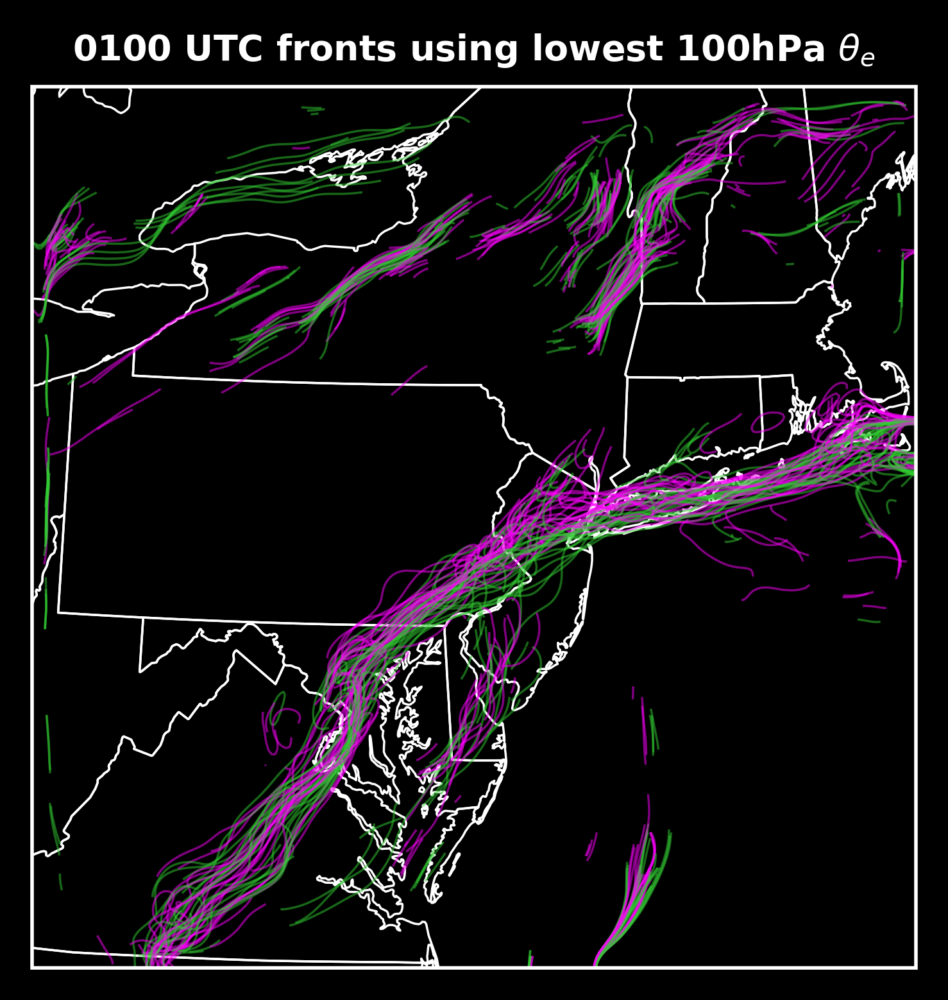

In [82]:
linewidths = 0.5

# Increase the figure height to make more room vertically
fig, ax = plt.subplots(
    1,
    1,
    figsize=(3, 3),  # Increased height from 3 to 4
    dpi=500,
    layout="constrained",
    subplot_kw=dict(projection=proj),
)

ax.set_title(
    r"0100 UTC fronts using lowest 100hPa $\theta_e$",
    fontsize=8,
    fontweight="bold",
)

# Iterate through each run and contour the zero line
for r in range(tfp_wet.shape[0]):
# for r in range(4,5):
    c_wet = ax.contour(
        lon,
        lat,
        tfp_wet[r],
        transform=ccrs.PlateCarree(),
        levels=[0],
        colors="limegreen",
        alpha=0.5,
        linewidths=linewidths
    )
    c_dry = ax.contour(
        lon,
        lat,
        tfp_dry[r],
        transform=ccrs.PlateCarree(),
        levels=[0],
        colors="magenta",
        alpha=0.5,
        linewidths=linewidths
    )

# Add state borders
ax.add_feature(cfeature.STATES, linewidth=0.5, edgecolor="white")

ax.set_extent(
    [
        -449900.09156094893,
        449900.51654555957,
        -447909.5438942791,
        448284.39736015256,
    ],
    crs=proj,
)


#### Plot V2

In [13]:
def get_biggest_blob(array_in: pint.Quantity) -> pint.Quantity:
    "Label all blobs and only return the biggest one"
    # Identify blobs
    labeled_array, num_features = label(np.isfinite(array_in))  # type: ignore

    # Find largest blob
    largest_blob_size, largest_blob_label = 0, None
    for l_idx in range(1, num_features + 1):
        blob_size = np.sum(labeled_array == l_idx)
        if blob_size > largest_blob_size:
            largest_blob_size, largest_blob_label = blob_size, l_idx

    return np.where(labeled_array == largest_blob_label, array_in, np.nan)  # type: ignore


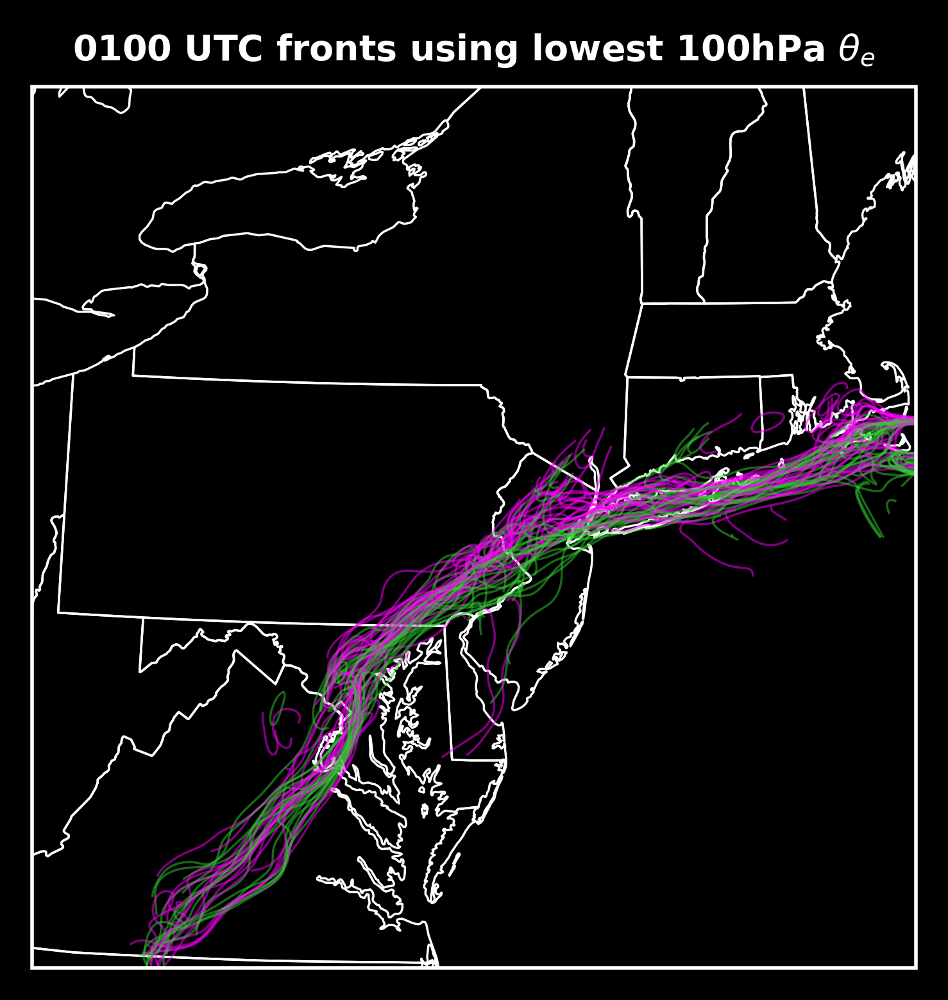

In [81]:
linewidths = 0.5

# Increase the figure height to make more room vertically
fig, ax = plt.subplots(
    1,
    1,
    figsize=(3, 3),  # Increased height from 3 to 4
    dpi=500,
    layout="constrained",
    subplot_kw=dict(projection=proj),
)

ax.set_title(
    r"0100 UTC fronts using lowest 100hPa $\theta_e$",
    fontsize=8,
    fontweight="bold",
)

# Iterate through each run and contour the zero line
for r in range(tfp_wet.shape[0]):
    wet_to_plot = get_biggest_blob(tfp_wet[r])
    c_wet = ax.contour(
        lon,
        lat,
        wet_to_plot,
        transform=ccrs.PlateCarree(),
        levels=[0],
        colors="limegreen",
        alpha=0.5,
        linewidths=linewidths
    )
    dry_to_plot = get_biggest_blob(tfp_dry[r])
    c_dry = ax.contour(
        lon,
        lat,
        dry_to_plot,
        transform=ccrs.PlateCarree(),
        levels=[0],
        colors="magenta",
        alpha=0.5,
        linewidths=linewidths
    )

# Add state borders
ax.add_feature(cfeature.STATES, linewidth=0.5, edgecolor="white")

ax.set_extent(
    [
        -449900.09156094893,
        449900.51654555957,
        -447909.5438942791,
        448284.39736015256,
    ],
    crs=proj,
)


In [118]:
# Make a distribution of mag(\nabla\theta_e)
thetae = (
    get_field(wofs_all, "theta_e", "2021-09-02 01:00:00", "2021-09-02 01:00:00", init)
    .squeeze()
    .stack(run=("init", "ne"))
    .transpose("run", "lat", "lon")
)

grad_thetae_y, grad_thetae_x = gradient(
    smooth_gaussian(thetae, n=30), axes=(-2, -1), deltas=(dy, dx)
)

# Calculate the gradient magnitude of thetae_wet
grad_thetae_magnitude = np.sqrt(grad_thetae_x**2 + grad_thetae_y**2)


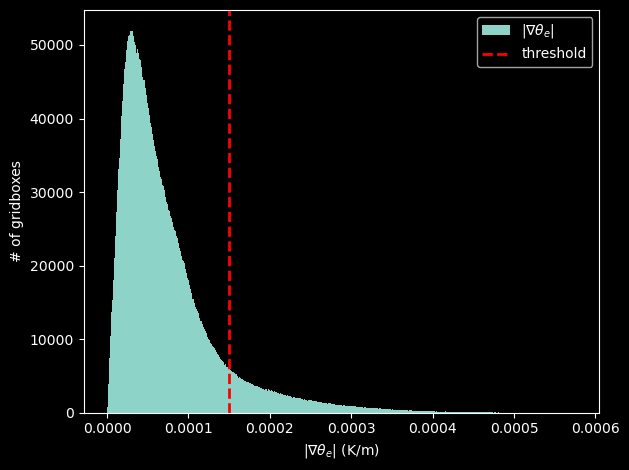

In [128]:
plt.hist(grad_thetae_magnitude.magnitude.flat, bins="auto", label=r"|$\nabla\theta_e$|")
plt.axvline(x=0.00015, color='red', linestyle='--', linewidth=2, label='threshold')
plt.legend(loc="best")
plt.xlabel(r"|$\nabla\theta_e$| (K/m)")
plt.ylabel("# of gridboxes")
plt.tight_layout()
plt.show()

## Repeat for more times

In [17]:
# Get the wet and dry ensembles thetae fields

thetae_wet = get_field(
    wofs_wet, "theta_e", "2021-09-01 23:00:00", "2021-09-02 03:00:00", init
).squeeze().stack(run=("init","ne")).transpose("time","run","lat","lon")[::12]
thetae_dry = get_field(
    wofs_dry, "theta_e", "2021-09-01 23:00:00", "2021-09-02 03:00:00", init
).squeeze().stack(run=("init","ne")).transpose("time","run","lat","lon")[::12]
thetae_all = get_field(
    wofs_all, "theta_e", "2021-09-01 23:00:00", "2021-09-02 03:00:00", init
).squeeze().stack(run=("init","ne")).transpose("time","run","lat","lon")[::12]


# For plotting the ensemble mean later, let's smooth now
thetae_all = smooth_gaussian(thetae_all.mean(dim="run"), n=30)


In [11]:
# Calculate the gradient of thetae_dry (returns two arrays: grad_x and grad_y)
grad_thetae_wet_y, grad_thetae_wet_x = gradient(
    smooth_gaussian(thetae_wet, n=30), axes=(-2, -1), deltas=(dy, dx)
)
grad_thetae_dry_y, grad_thetae_dry_x = gradient(
    smooth_gaussian(thetae_dry, n=30), axes=(-2, -1), deltas=(dy, dx)
)

# Calculate the gradient magnitude of thetae_wet
grad_thetae_wet_magnitude = np.sqrt(grad_thetae_wet_x**2 + grad_thetae_wet_y**2)
grad_thetae_dry_magnitude = np.sqrt(grad_thetae_dry_x**2 + grad_thetae_dry_y**2)

# Normalize to find component orthogonal to gradient
grad_thetae_wet_unit_x = grad_thetae_wet_x / grad_thetae_wet_magnitude
grad_thetae_wet_unit_y = grad_thetae_wet_y / grad_thetae_wet_magnitude
grad_thetae_dry_unit_x = grad_thetae_dry_x / grad_thetae_dry_magnitude
grad_thetae_dry_unit_y = grad_thetae_dry_y / grad_thetae_dry_magnitude

# Calculate the gradient of the gradient magnitude
grad_mag_wet_y, grad_mag_wet_x = gradient(
    grad_thetae_wet_magnitude, axes=(-2, -1), deltas=(dy, dx)
)
grad_mag_dry_y, grad_mag_dry_x = gradient(
    grad_thetae_dry_magnitude, axes=(-2, -1), deltas=(dy, dx)
)

In [12]:
# Calculate the TFP as the negative dot product of the gradients
tfp_wet = -(
    grad_thetae_wet_unit_x * grad_mag_wet_x + grad_thetae_wet_unit_y * grad_mag_wet_y
)
tfp_dry = -(
    grad_thetae_dry_unit_x * grad_mag_dry_x + grad_thetae_dry_unit_y * grad_mag_dry_y
)


# Set a threshold based on apriori thetae gradients
threshold = (15 * units.kelvin / units.km).to("K/m") / 100

tfp_wet = np.where(grad_thetae_wet_magnitude > threshold, tfp_wet, np.nan)
tfp_dry = np.where(grad_thetae_dry_magnitude > threshold, tfp_dry, np.nan)


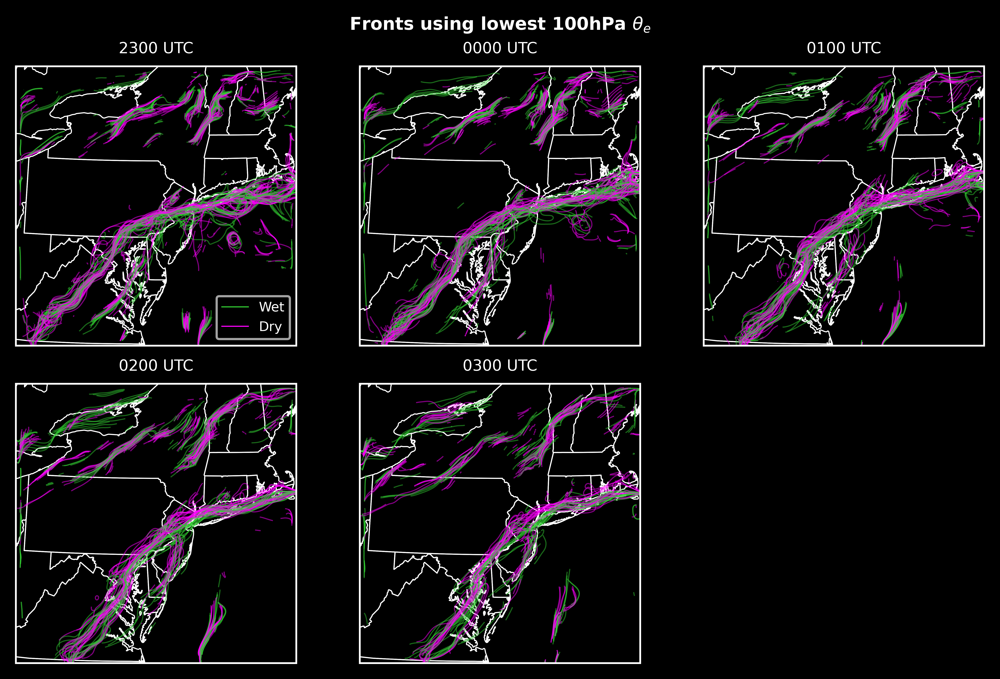

In [11]:
linewidths = 0.5

titles = ["23:00 UTC", "00:00 UTC", "01:00 UTC", "02:00 UTC", "03:00 UTC"]

# Increase the figure height to make more room vertically
fig, axes = plt.subplots(
    2,
    3,
    figsize=(6.5, 4),  # Increased height from 3 to 4
    dpi=900,
    layout="constrained",
    subplot_kw=dict(projection=proj),
)

plt.suptitle(
    r"Fronts using lowest 100hPa $\theta_e$", fontsize=8, fontweight="bold", y=1.03
)

for i, ax in enumerate(axes.flatten()[:-1]):
    # Iterate through each run and contour the zero line
    for r in range(tfp_wet.shape[1]):
        c_wet = ax.contour(
            lon,
            lat,
            tfp_wet[i, r],
            transform=ccrs.PlateCarree(),
            levels=[0],
            colors="limegreen",
            alpha=0.5,
            linewidths=linewidths,
        )
        c_dry = ax.contour(
            lon,
            lat,
            tfp_dry[i, r],
            transform=ccrs.PlateCarree(),
            levels=[0],
            colors="magenta",
            alpha=0.5,
            linewidths=linewidths,
        )

    # Add state borders
    ax.add_feature(cfeature.STATES, linewidth=0.5, edgecolor="white")

    ax.set_extent(
        [
            -449900.09156094893,
            449900.51654555957,
            -447909.5438942791,
            448284.39736015256,
        ],
        crs=proj,
    )

    ax.set_title(titles[i], fontsize=7)

wet_handle = mlines.Line2D([], [], color='limegreen', label='Wet', linewidth=linewidths)
dry_handle = mlines.Line2D([], [], color='magenta', label='Dry', linewidth=linewidths)

axes.flat[0].legend(handles=[wet_handle, dry_handle], loc="lower right", fontsize=6)

plt.delaxes(axes.flat[-1])

plt.show()

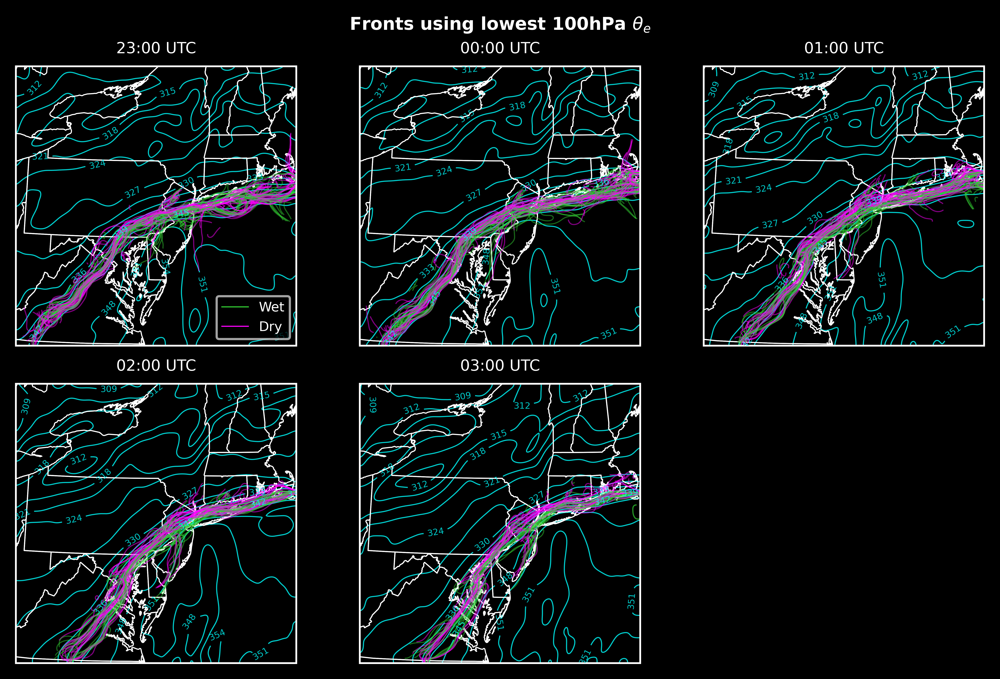

In [24]:
linewidths = 0.5

titles = ["23:00 UTC", "00:00 UTC", "01:00 UTC", "02:00 UTC", "03:00 UTC"]

# Increase the figure height to make more room vertically
fig, axes = plt.subplots(
    2,
    3,
    figsize=(6.5, 4),  # Increased height from 3 to 4
    dpi=900,
    layout="constrained",
    subplot_kw=dict(projection=proj),
)

plt.suptitle(
    r"Fronts using lowest 100hPa $\theta_e$", fontsize=8, fontweight="bold", y=1.03
)

for i, ax in enumerate(axes.flatten()[:-1]):
    # Iterate through each run and contour the zero line
    for r in range(tfp_wet.shape[1]):
        wet_to_plot = get_biggest_blob(tfp_wet[i, r])
        c_wet = ax.contour(
            lon,
            lat,
            wet_to_plot,
            transform=ccrs.PlateCarree(),
            levels=[0],
            colors="limegreen",
            alpha=0.5,
            linewidths=linewidths,
            zorder=2
        )
        dry_to_plot = get_biggest_blob(tfp_dry[i, r])
        c_dry = ax.contour(
            lon,
            lat,
            dry_to_plot,
            transform=ccrs.PlateCarree(),
            levels=[0],
            colors="magenta",
            alpha=0.5,
            linewidths=linewidths,
            zorder=2
        )

    # Plot ensemble mean
    c_all = ax.contour(
        lon,
        lat,
        thetae_all[i, :, :],
        transform=ccrs.PlateCarree(),
        colors="cyan",
        linewidths=linewidths,
        levels=range(273, 357, 3),
        alpha=0.8,
        zorder=1
    )

    ax.clabel(c_all, c_all.levels, fontsize=4)

    # Add state borders
    ax.add_feature(cfeature.STATES, linewidth=0.5, edgecolor="white")

    ax.set_extent(
        [
            -449900.09156094893,
            449900.51654555957,
            -447909.5438942791,
            448284.39736015256,
        ],
        crs=proj,
    )

    ax.set_title(titles[i], fontsize=7)

wet_handle = mlines.Line2D([], [], color="limegreen", label="Wet", linewidth=linewidths)
dry_handle = mlines.Line2D([], [], color="magenta", label="Dry", linewidth=linewidths)

axes.flat[0].legend(handles=[wet_handle, dry_handle], loc="lower right", fontsize=6)

plt.delaxes(axes.flat[-1])

plt.show()